<a href="https://colab.research.google.com/github/RamSaw/image-processing/blob/master/Copy_of_homework2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Домашнее задание №2

Задание присылать на обе почты почты aleksartamonov@gmail.com dashkov.alexander.om@gmail.com в виде ссылки на colab

В теме письма указать **HSE2020 HW2 <Фамилия Имя>**

soft deadline: 09.02.2020T23:59:00+0300

hard deadline: 16.02.2020T23:59:00+0300

In [2]:
from google.colab import drive
drive.mount('./gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at ./gdrive


In [0]:
ROOT_PATH = './gdrive/My Drive/hw2/'

In [0]:
def get_path(filename):
  import os
  return os.path.join(ROOT_PATH, filename)

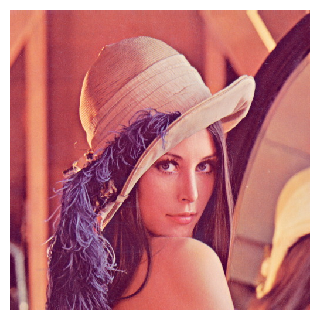

In [7]:
import numpy as np
import cv2
import matplotlib.pylab as plt
%matplotlib inline
plt.style.use('default')

def show(img, size=3):
    plt.figure(figsize=(size,size))
    ax = plt.axes([0,0,1,1], frameon=False)
    ax.set_axis_off()
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

def show_rgb(img, size=3):
    plt.figure(figsize=(size,size))
    ax = plt.axes([0,0,1,1], frameon=False)
    ax.set_axis_off()
    plt.imshow(img)

lena = cv2.imread(get_path("lena.jpg"))
lena_rgb = cv2.cvtColor(lena, cv2.COLOR_BGR2RGB)
show_rgb(lena_rgb)

**1. (6 баллов)** С помощью [виджетов](http://ipywidgets.readthedocs.io/en/latest/examples/Widget%20List.html) создайте 2 слайдера с настройками параметров гамма-коррекции. Отобразите **lena**, ее гамма-преобразование и график в диапозоне от [0;1], так, чтобы параметры слайдера соответствовали параметрам гамма-коррекции. 

In [49]:
import ipywidgets as widgets


c_widget = widgets.FloatSlider(
    value=1.,
    min=0,
    max=2.0,
    step=0.1,
    description='c:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='.1f',
)

gamma_widget = widgets.FloatSlider(
    value=1.,
    min=0,
    max=2.0,
    step=0.01,
    description='gamma:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True
)

def gamma_function(values, c, gamma):
    res = c * np.power(values, gamma)
    res[res > 1] = 1
    return res

def gamma_transform(image, c, gamma):
    res = (gamma_function(image / 255, c, gamma) * 255).astype(int)
    return res

def update_function(c, gamma):
    res = gamma_transform(lena_rgb, c, gamma)
    x_values = np.linspace(0, 1, 101)
    plt.plot(x_values, gamma_function(x_values, c, gamma))
    show_rgb(res)

wg.interact(update_function, c=c_widget, gamma=gamma_widget)

interactive(children=(FloatSlider(value=1.0, continuous_update=False, description='c:', max=2.0, readout_forma…

<function __main__.update_function>

**2. (5 баллов)** Загрузите изображение $lena.jpg$. Переведите изображение в градации серого. Примените к серому изображению операцию линейного растяжения диапазона яркостей ($normalize$) и эквализации гистограммы ($equalizeHist$). Постройте разность полученных результатов. Состыкуйте в одно изображение в градациях серого результат линейного растяжения, эквализации и их разности.

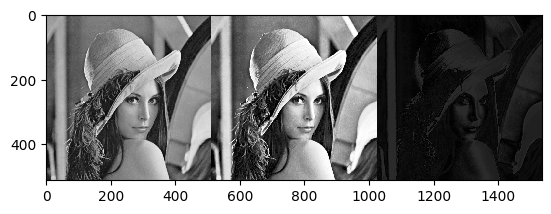

In [9]:
lena_gray = cv2.cvtColor(lena_rgb, cv2.COLOR_RGB2GRAY)
lena_normalized = cv2.normalize(lena_gray, dst=None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
lena_equalizehist = cv2.equalizeHist(lena_gray)
lena_diff_gray = np.abs(lena_equalizehist.astype(int) - lena_normalized.astype(int))
lena_gray_stacked = np.concatenate((lena_normalized, lena_equalizehist, lena_diff_gray), axis=1)
plt.imshow(lena_gray_stacked, cmap='gray')

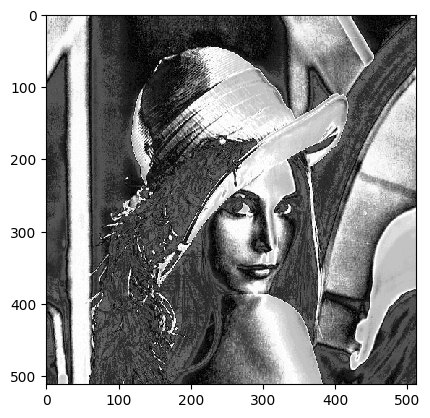

In [90]:
# интересно то, что отдельно lena_diff_gray выглядит сильно ярче
# не очень понимаю, это я как-то неправильно пользуюсь imshow или это "фича" нашего зрения...
plt.imshow(lena_diff_gray, cmap='gray')

**3. (5 баллов)** Реализуйте функцию добавления шума «соль и перец» для одноканального изображения. Входные параметры: $src$ – исходная одноканальная матрица $Mat$, $p$ – вероятность замещения исходных значений на $0$, $q$ – вероятность замещения исходных значений на $255$. Загрузите изображение $lena.jpg$, выделите каналы изображения в отдельные матрицы ($split$), добавьте шум «соль и перец» в каждый канал при помощи реализованной Вами функции с параметрами

1. $p=q=0.05$
2. $p=q=0.1$
3. $p=q=0.15$

In [0]:
def salt_pepper(src, p, q):
    img = src.copy()
    
    to_change = np.random.choice([0, 1, 2], size=img.shape, p=[p, q, 1 - (p + q)])
    img[to_change == 0] = 0
    img[to_change == 1] = 255
    return img

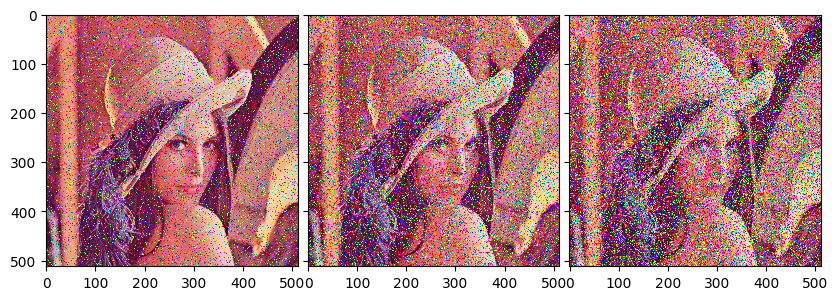

In [51]:
from mpl_toolkits.axes_grid1 import ImageGrid
lena_channels = np.split(lena_rgb, 3, axis=-1)
probs = [(0.05, 0.05), (0.1, 0.1), (0.15, 0.15)]
images_per_probs = []

for prob in probs:
    lena_channels_with_salt = [salt_pepper(lena_channel, prob[0], prob[1]) for lena_channel in lena_channels]
    images_per_probs.append(np.concatenate(lena_channels_with_salt, axis=-1))

fig = plt.figure(figsize=(10., 10.))
grid = ImageGrid(fig, 111, nrows_ncols=(1, 3), axes_pad=0.1)
for ax, im in zip(grid, images_per_probs):
    ax.imshow(im)
plt.show()

**4. (5 баллов)** Удалите диагональные полоски с изображения $lena\_diagonal.jpg$. Вычислите среднеквадратичную ошибку (mean squared error, $MSE$) для полученного результата и изображения $lena\_gray\_512.tif$. Задача будет засчитана при $MSE < 1500$. Тот, у кого по результатам проверки будет наименьшее значение MSE среди всех студентов для этой задачи, получит призовую шоколадку (раньше мы раздавали призовые баллы, но теперь у нас концепция фиксированного максимального количества баллов)

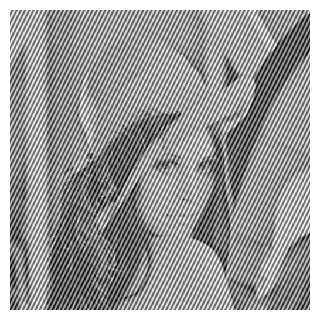

In [70]:
lena_diagonal = cv2.imread(get_path("lena_diagonal.jpg"))
lena_diagonal = cv2.cvtColor(lena_diagonal, cv2.COLOR_BGR2RGB)
show_rgb(lena_diagonal)

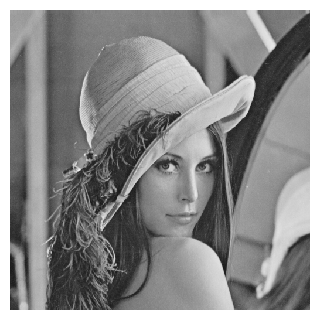

In [72]:
lena_tif = cv2.imread(get_path("lena_gray_512.tif"))
lena_tif = cv2.cvtColor(lena_tif, cv2.COLOR_BGR2RGB)
show_rgb(lena_tif)

In [0]:
def mse_func(out, target):
  return ((out.astype(float) - target.astype(float)) ** 2).mean()

In [214]:
print(f'Initial mse: {mse_func(lena_diagonal, lena_tif)}')

Initial mse: 3484.66450881958


In [0]:
def remove_diagonal(img):
    return cv2.GaussianBlur(img, (15, 15), 0)

Final mse: 975.2541732788086


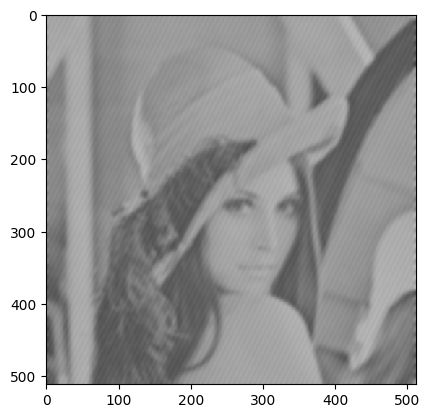

In [216]:
lena_removed_diagonal = remove_diagonal(lena_diagonal)
print(f'Final mse: {mse_func(lena_removed_diagonal, lena_tif)}')
plt.imshow(lena_removed_diagonal, cmap='gray')

**5. (5 баллов)** Подавите шум на изображении $lena\_color\_512\_noise.tif$. Вычислите среднеквадратичную ошибку ($MSE$) для полученного результата и изображения $lena\_color\_512.tif$. Задача будет засчитана при $MSE < 150$. Тот, у кого по результатам проверки будет наименьшее значение $MSE$ среди всех студентов для этой задачи, получит призовую шоколадку.

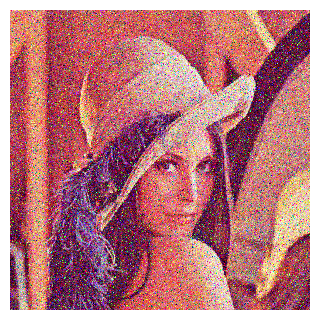

In [122]:
lena_tif_noise = cv2.imread(get_path("lena_color_512-noise.tif"))
lena_tif_noise = cv2.cvtColor(lena_tif_noise, cv2.COLOR_BGR2RGB)
show_rgb(lena_tif_noise)

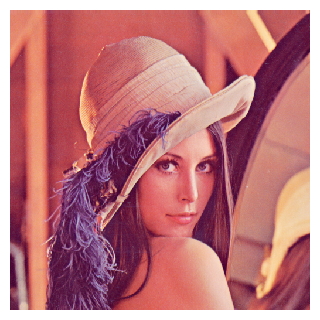

In [123]:
lena_tif_target = cv2.imread(get_path("lena_color_512.tif"))
lena_tif_target = cv2.cvtColor(lena_tif_target, cv2.COLOR_BGR2RGB)
show_rgb(lena_tif_target)

In [125]:
print(f'Initial mse: {mse_func(lena_tif_noise, lena_tif_target)}')

Initial mse: 2184.1810162862143


In [0]:
def remove_noise(img):
  return cv2.fastNlMeansDenoisingColored(cv2.medianBlur(img, 5), None, 9, 9)

Final mse: 104.3058687845866


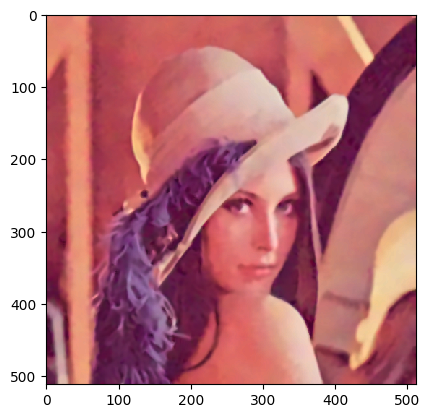

In [183]:
lena_tif_without_noise = remove_noise(lena_tif_noise)
print(f'Final mse: {mse_func(lena_tif_without_noise, lena_tif_target)}')
plt.imshow(lena_tif_without_noise)

**6. (5 баллов)** Выделите в изображении $table.jpg$ границы таблицы с использованием морфологических операций. Результатом обработки должно быть изображение, в котором удален весь текст и оставлены только границы таблицы

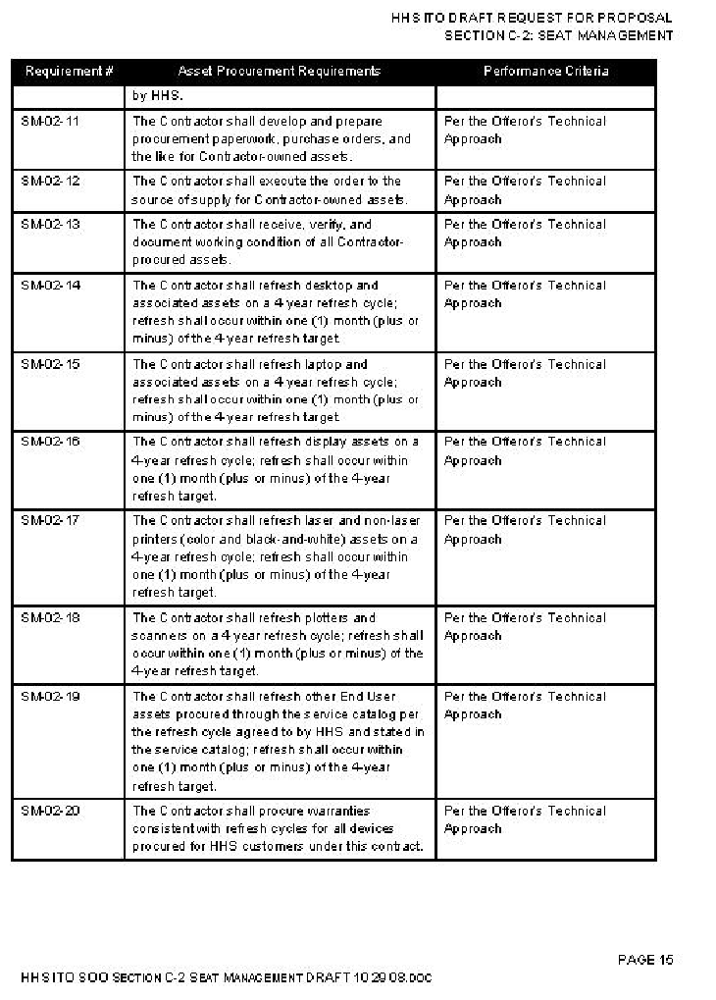

In [182]:
table = cv2.imread(get_path("table.jpg"))
table = cv2.cvtColor(table, cv2.COLOR_BGR2RGB)
show_rgb(table, size=10)

In [0]:
def extract_vertical_lines(img):
  return cv2.morphologyEx(img, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_RECT, (1, 10)))

def extract_horizontal_lines(img):
    return cv2.morphologyEx(
        cv2.morphologyEx(img, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_RECT, (10, 1))), 
        cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_RECT, (5, 8)))

def extract_border(img):
    _, binarized_img = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
    vertical_lines = extract_vertical_lines(binarized_img)
    horizontal_lines = extract_horizontal_lines(binarized_img)
    border = np.zeros_like(binarized_img)
    border[vertical_lines > horizontal_lines] = horizontal_lines[vertical_lines > horizontal_lines]
    border[vertical_lines <= horizontal_lines] = vertical_lines[vertical_lines <= horizontal_lines]
    return border

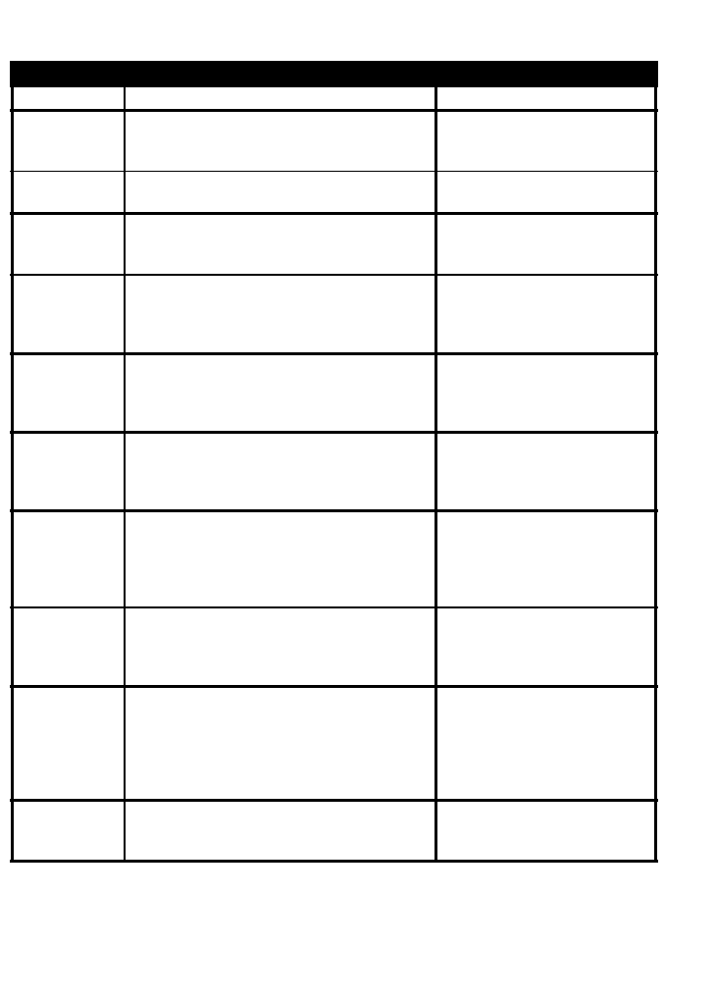

In [292]:
border = extract_border(table)
show_rgb(border, size=10)

**7. (5 баллов)** Отделите монеты от фона на изображении $coins\_1.jpg$, отсортируйте монеты по убыванию размера. Сгенерируйте результирующее изображение с цветной разметкой областей, соответствующих монетам на исходном изображении: на черном фоне должны быть выделены разными цветами области, соответствующие монетам. В центре каждой выделенной области разместите порядковый номер монеты в соответствии с сортировкой монет по размеру (в центре области, соответствующей самой большой монете, должно стоять число 1)

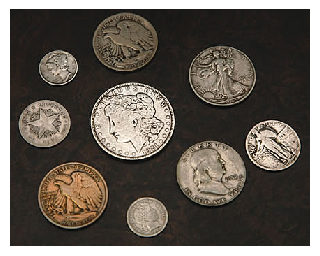

In [293]:
coins_1 = cv2.imread(get_path("coins_1.jpg"))
coins_1 = cv2.cvtColor(coins_1, cv2.COLOR_BGR2RGB)
show_rgb(coins_1)

In [0]:
def detect_coins(img):
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_thresholded = cv2.adaptiveThreshold(img_gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 99, -9)
    countours, ret = cv2.findContours(img_thresholded, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    sorted_coins_contours = sorted(countours, key=cv2.contourArea, reverse=True)[:9]
    sorted_coins_contours = [cv2.fitEllipse(coin_contour) for coin_contour in sorted_coins_contours]
    colors = [(255, 255, 255), (230, 100, 1), (24, 98, 255), (23, 3, 160), (2, 255, 255), (255, 0, 255), (24, 166, 44), (244, 0, 0), (23, 233, 2)]
    detected_coins = np.zeros_like(img)
    for i, coin_contour in enumerate(sorted_coins_contours):
        cv2.ellipse(detected_coins, coin_contour, color=colors[i], thickness=-1)
        cv2.putText(detected_coins, text=str(i + 1), org=(int(coin_contour[0][0]) - 10, int(coin_contour[0][1]) + 10), fontFace=0, fontScale=1, color=(0, 0, 0))
    return detected_coins

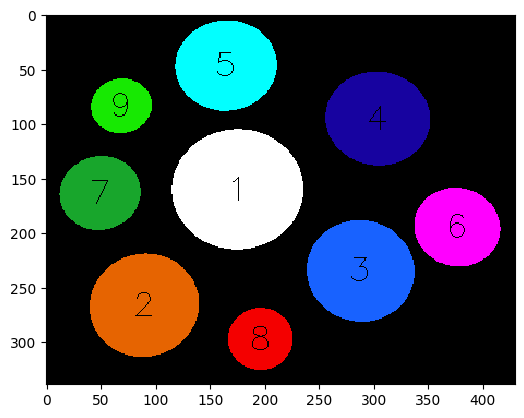

In [394]:
detected_coins = detect_coins(coins_1)
plt.imshow(detected_coins)

**8. (5 баллов)** Отделите монеты от текста на изображении $coins\_2.jpg.$ Сгенерируйте по входному изображению два изображения: на одном должны остаться только монеты, весь текст должен быть удален; на втором изображении должен остаться только текст, все монеты должны быть удалены.

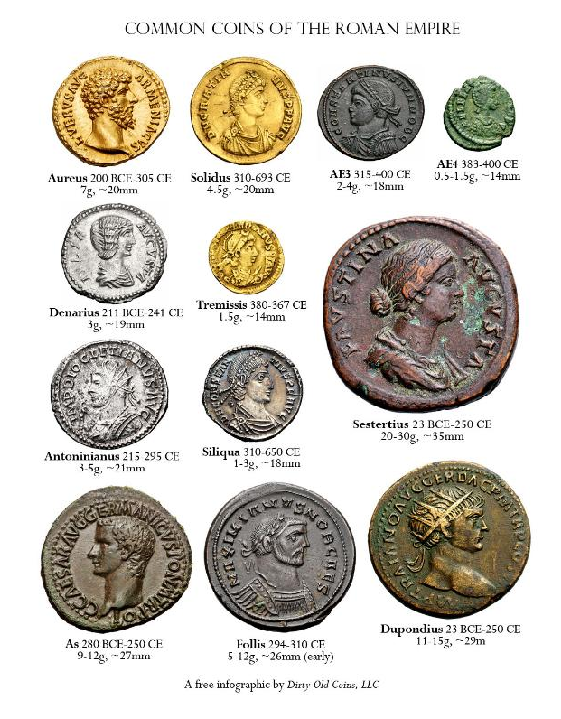

In [518]:
coins_2 = cv2.imread(get_path("coins_2.jpg"))
coins_2 = cv2.cvtColor(coins_2, cv2.COLOR_BGR2RGB)
show_rgb(coins_2, size=7)

In [0]:
def extract_coins(img):
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    _, binarized_img = cv2.threshold(img_gray, 230, 255, cv2.THRESH_BINARY)
    only_coins = ~cv2.morphologyEx(binarized_img, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5)))
    only_coins = cv2.cvtColor(only_coins, cv2.COLOR_GRAY2RGB)
    only_coins = only_coins & img
    only_coins[only_coins == 0] = 255
    return only_coins

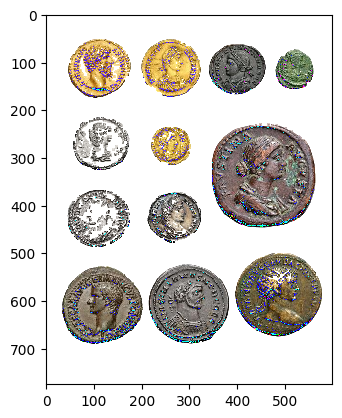

In [520]:
extracted_coins = extract_coins(coins_2)
plt.imshow(extracted_coins)

In [0]:
def extract_text(img):
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    _, binarized_img = cv2.threshold(img_gray, 230, 255, cv2.THRESH_BINARY)
    only_coins = ~cv2.morphologyEx(binarized_img, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5)))
    only_coins = ~cv2.cvtColor(only_coins, cv2.COLOR_GRAY2RGB)
    binarized_img = cv2.cvtColor(binarized_img, cv2.COLOR_GRAY2RGB)
    white_data = ~(binarized_img & only_coins)
    text = ~(cv2.erode(only_coins, cv2.getStructuringElement(cv2.MORPH_RECT, (10, 10))) & white_data)
    return text

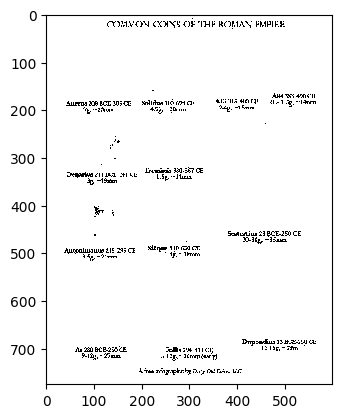

In [541]:
extracted_text = extract_text(coins_2)
plt.imshow(extracted_text)

### Сравнение глобальных признаков 

Для задач 9 и 10 надо реализовать общую функцию, которая принимет на вход:

* список дескрипторов (**id**, и сам дескриптор) 
* количество максимально похожих для вывода **n**
* функцию сранения дескрипторов

и отдает **n** пар **id** максимально похожих изображений.

In [0]:
def find_nearest(descs, n, comparator):
    img_num = len(descs)
    best_pairs = []
    for i in range(img_num):
      for j in range(i):
        best_pairs.append((i, j))
    return sorted(best_pairs, key=lambda id_pair: comparator(descs[id_pair[0]], descs[id_pair[1]]))[:n]

**9. (9 баллов)** Посмотрите на изображения в папке *Coral*. Посчитайте гистограммы изображений. Выведите на экран 20 пар изображений с максимально похожими гистограммами. В этом задании надо попробовать:
* различные цветовые пространства (RGB, HSV, CIELab)
* различные способы разбиения на бины (разное количество для каждой характеристики)
* различные метрики сравнения $L_2$, $\chi^2$, пересечение гистограм

In [0]:
def get_histogram(img, bin_factor):
    return np.concatenate([cv2.calcHist([img], [i], None, histSize=[bin_factor], ranges=[0, 255]) for i in range(img.shape[-1])])

In [0]:
def show_pairs(images, pairs):
    for i, j in pairs:
        fig = plt.figure(figsize=(5., 5.))
        grid = ImageGrid(fig, 111, nrows_ncols=(1, 2), axes_pad=0.1)
        for ax, im in zip(grid, [images[i], images[j]]):
            ax.imshow(im)
        plt.show()

In [0]:
coral_images = [cv2.cvtColor(cv2.imread(os.path.join(get_path('datasets/Corel'), filename)), cv2.COLOR_BGR2RGB) for filename in os.listdir(get_path('datasets/Corel'))]
hsv_coral_images = [cv2.cvtColor(img, cv2.COLOR_RGB2HSV) for img in coral_images]
lab_coral_images = [cv2.cvtColor(img, cv2.COLOR_RGB2LAB) for img in coral_images]

In [0]:
N = 20

In [0]:
def l2_distance(hist1, hist2):
    return ((hist1 - hist2) ** 2).sum()

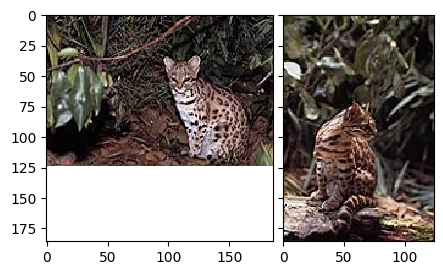

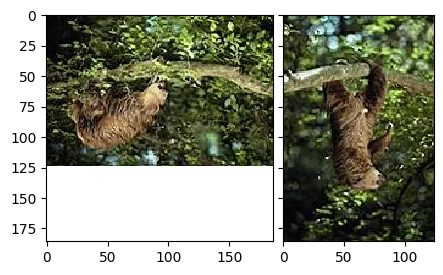

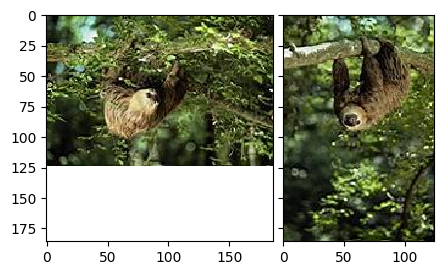

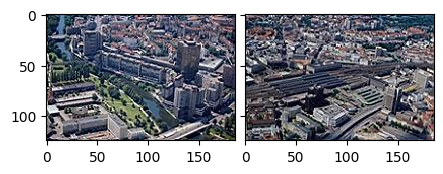

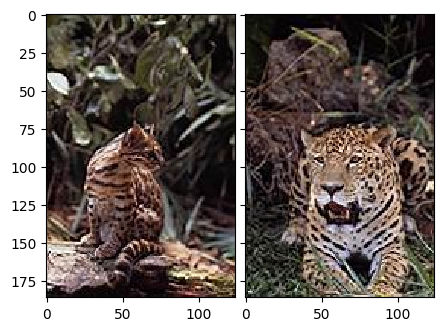

...

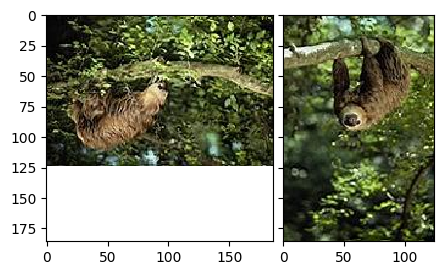

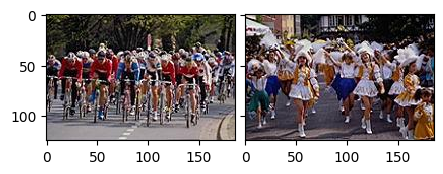

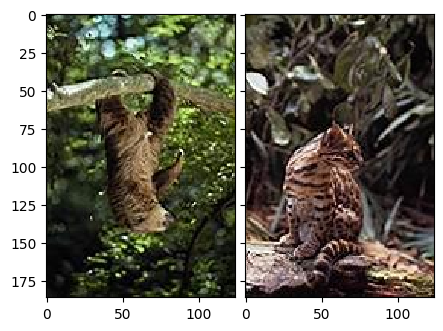

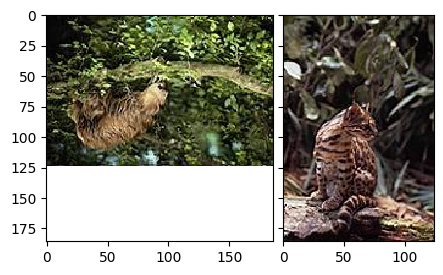

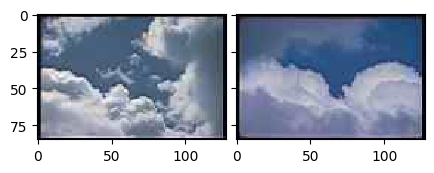

In [698]:
show_pairs(coral_images, find_nearest([get_histogram(i, 8) for i in coral_images], N, l2_distance))

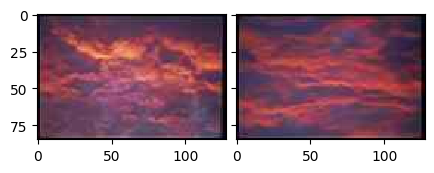

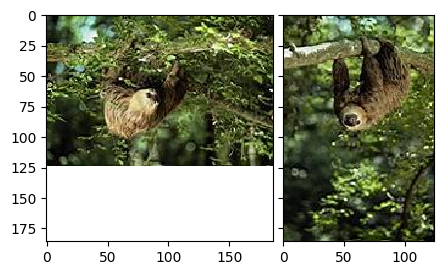

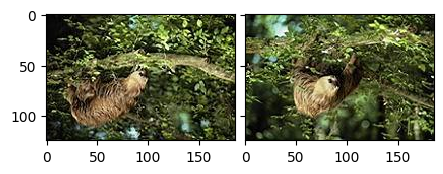

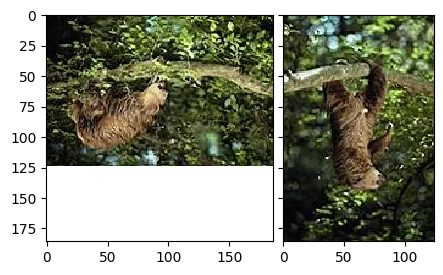

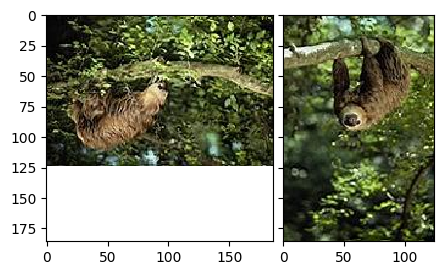

...

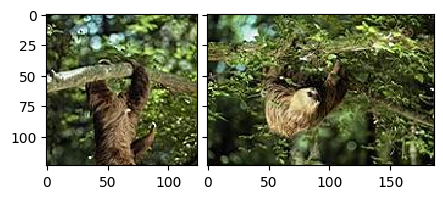

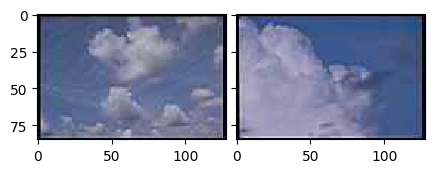

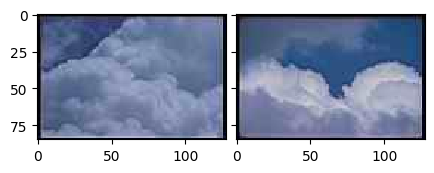

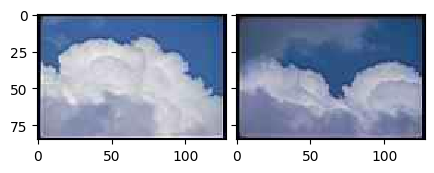

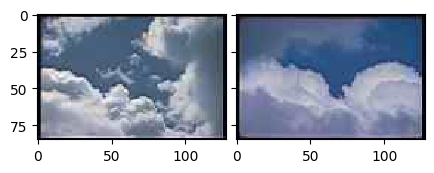

In [699]:
show_pairs(coral_images, find_nearest([get_histogram(i, 16) for i in hsv_coral_images], N, l2_distance))

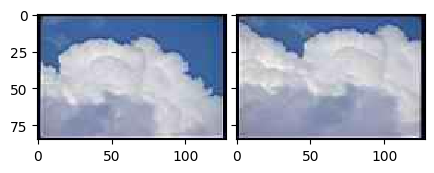

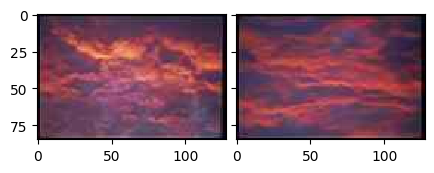

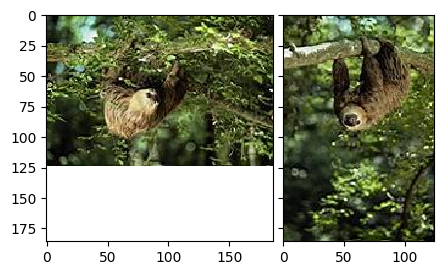

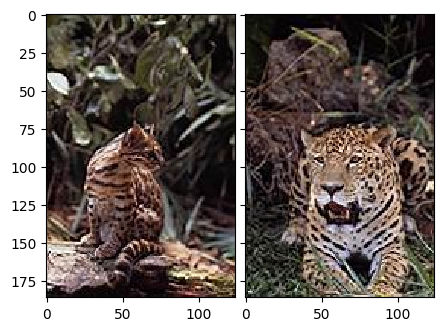

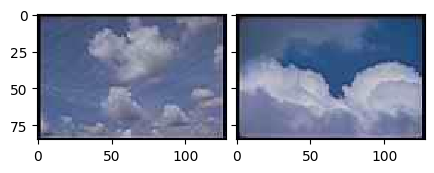

...

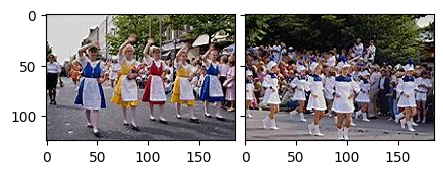

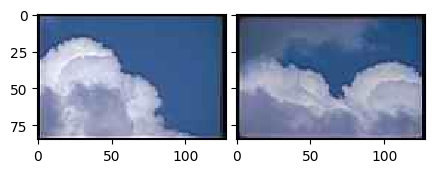

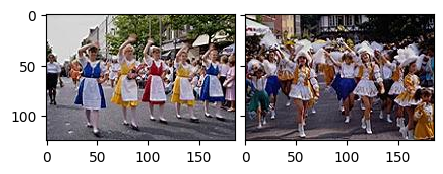

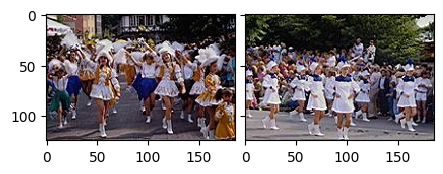

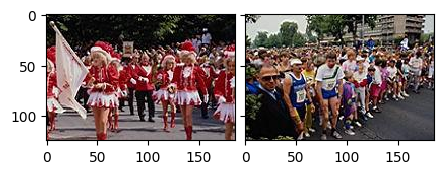

In [700]:
show_pairs(coral_images, find_nearest([get_histogram(i, 32) for i in lab_coral_images], N, l2_distance))

In [0]:
def xi_distance(hist1, hist2):
    return cv2.compareHist(hist1, hist2, cv2.HISTCMP_CHISQR)

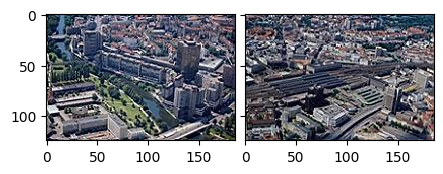

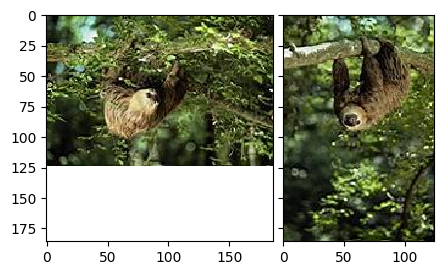

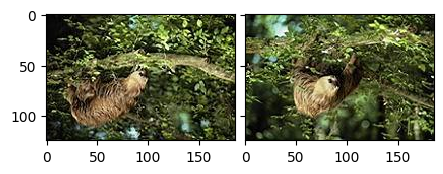

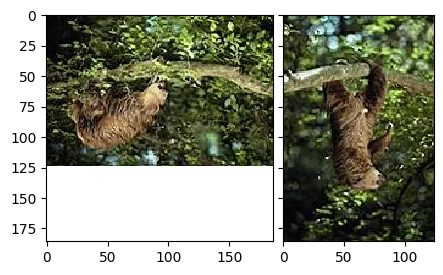

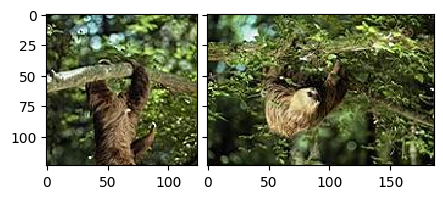

...

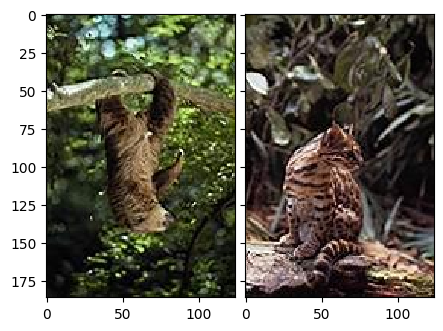

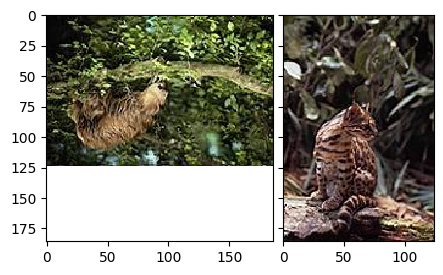

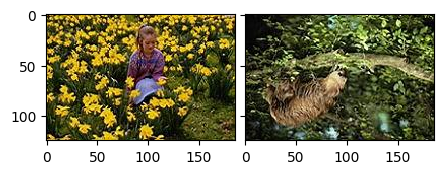

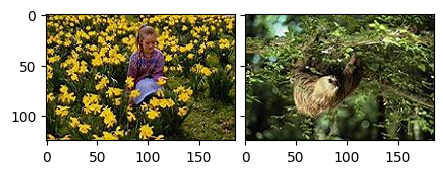

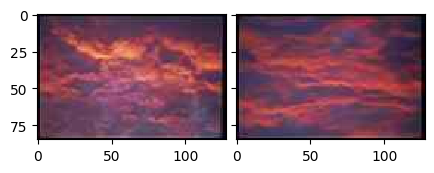

In [702]:
show_pairs(coral_images, find_nearest([get_histogram(i, 64) for i in coral_images], N, xi_distance))

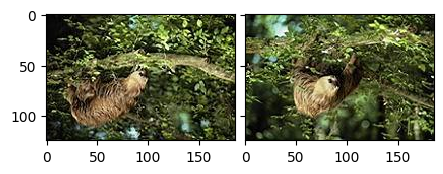

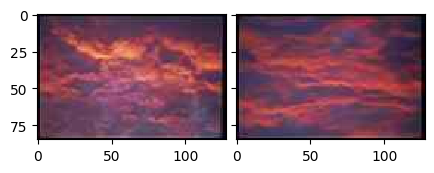

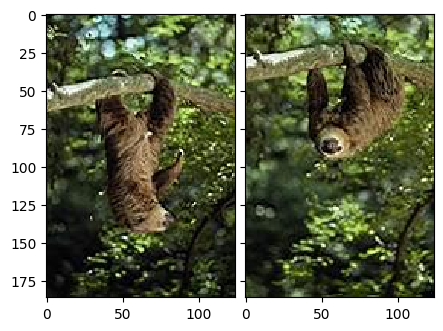

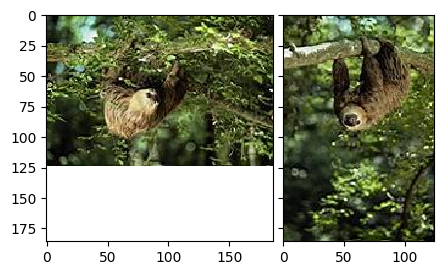

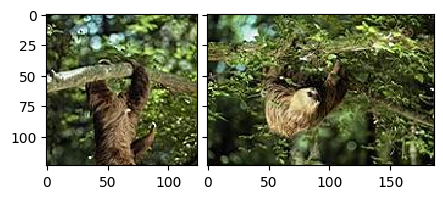

...

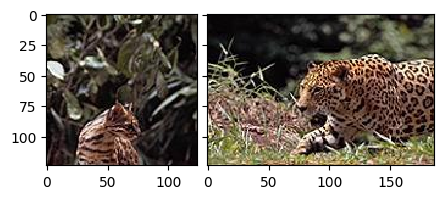

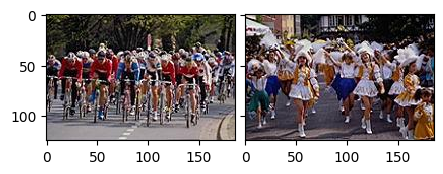

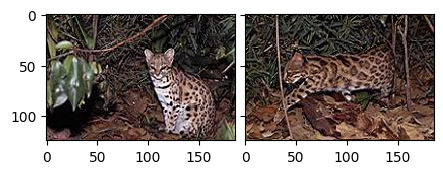

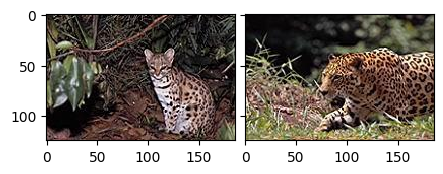

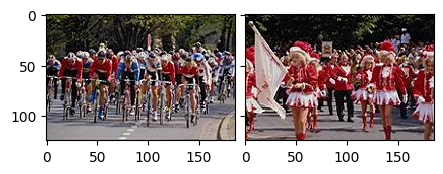

In [703]:
show_pairs(coral_images, find_nearest([get_histogram(i, 96) for i in hsv_coral_images], N, xi_distance))

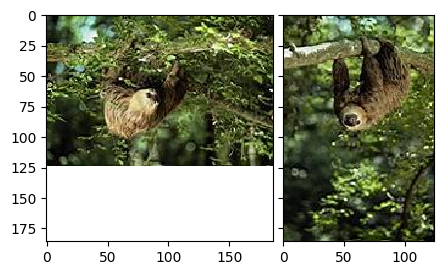

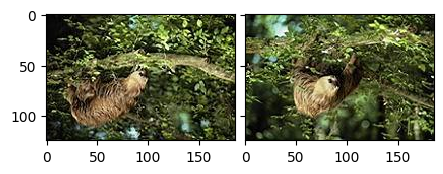

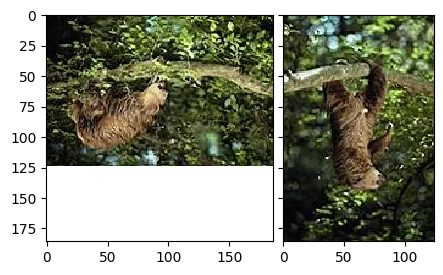

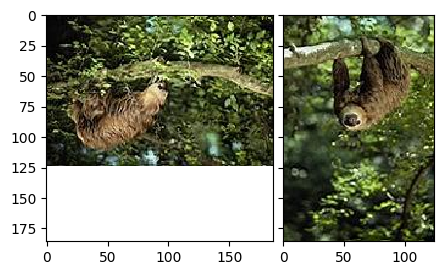

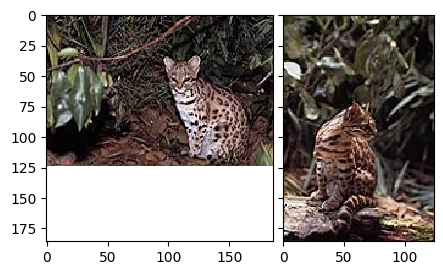

...

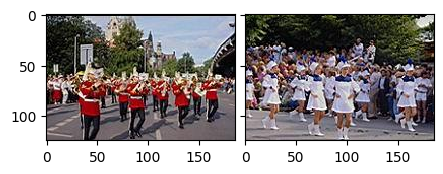

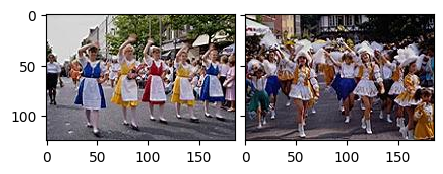

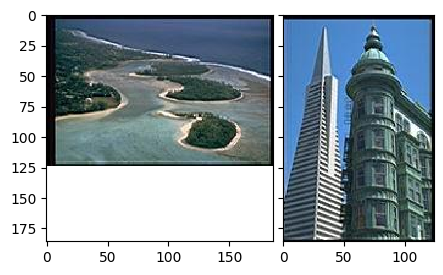

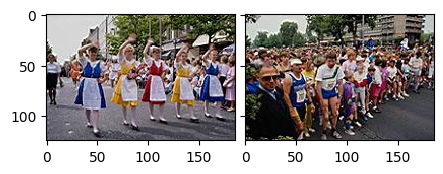

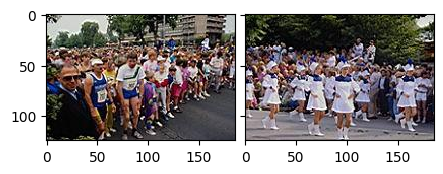

In [704]:
show_pairs(coral_images, find_nearest([get_histogram(i, 128) for i in lab_coral_images], N, xi_distance))

In [0]:
def intersection_distance(hist1, hist2):
    return -cv2.compareHist(hist1, hist2, cv2.HISTCMP_INTERSECT)

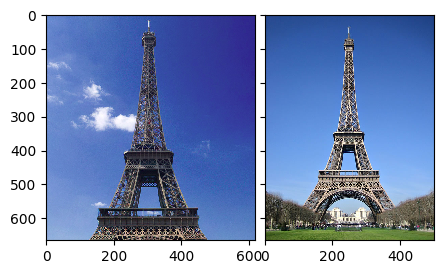

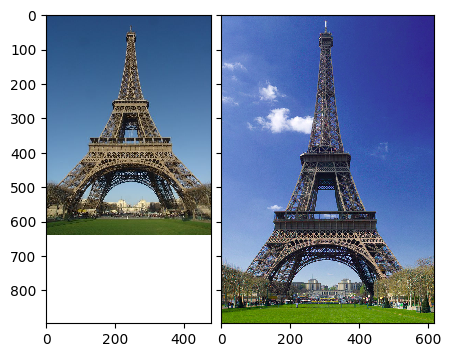

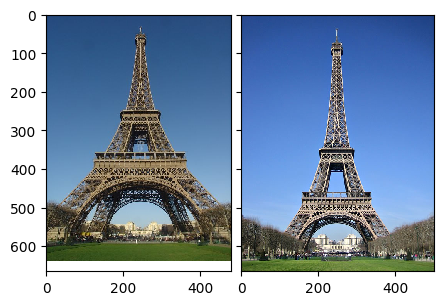

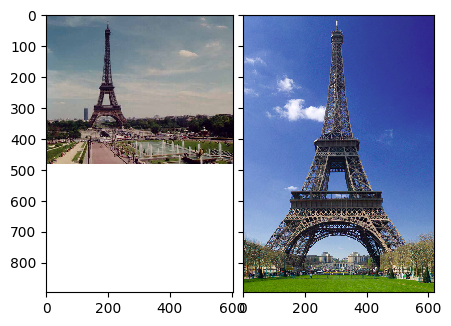

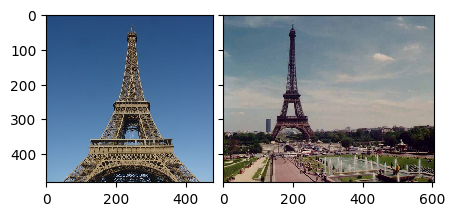

...

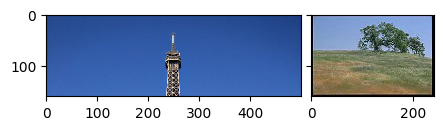

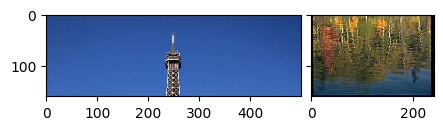

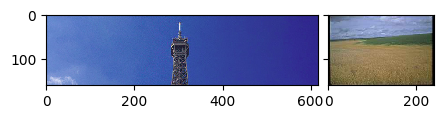

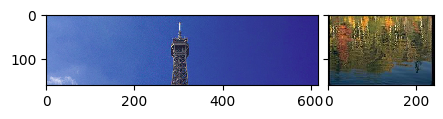

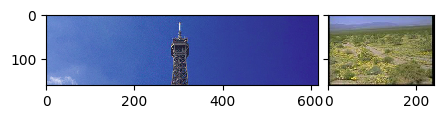

In [706]:
show_pairs(coral_images, find_nearest([get_histogram(i, 164) for i in coral_images], N, intersection_distance))

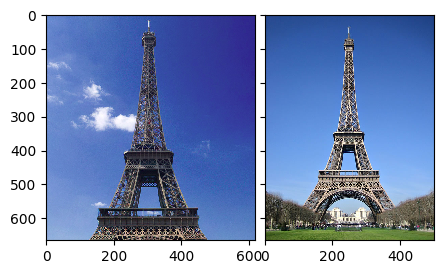

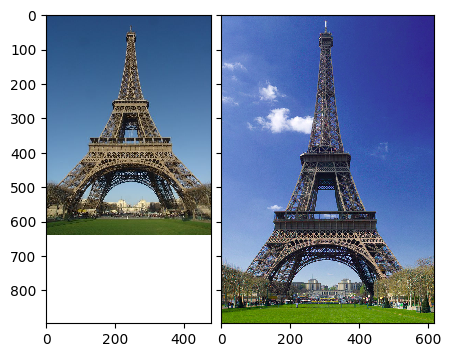

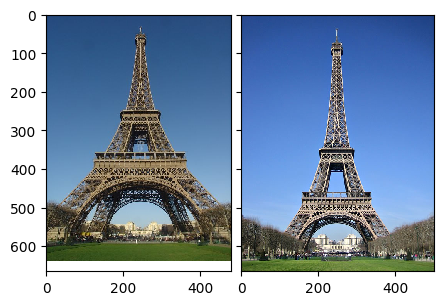

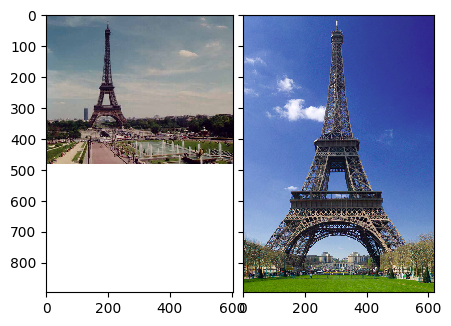

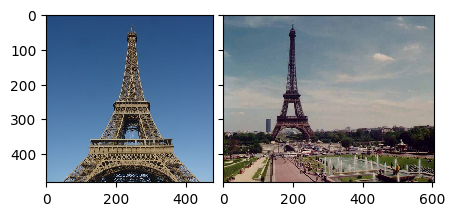

...

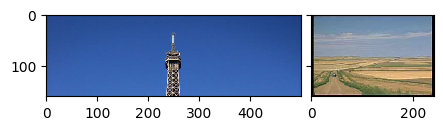

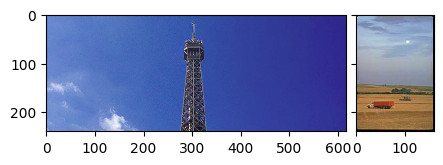

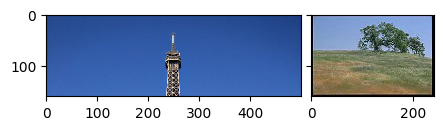

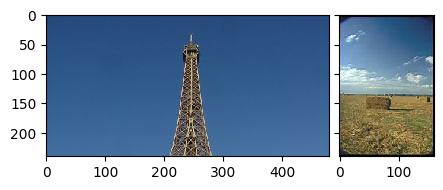

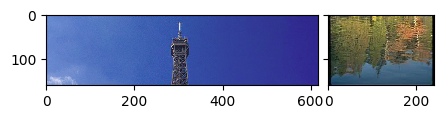

In [707]:
show_pairs(coral_images, find_nearest([get_histogram(i, 256) for i in hsv_coral_images], N, intersection_distance))

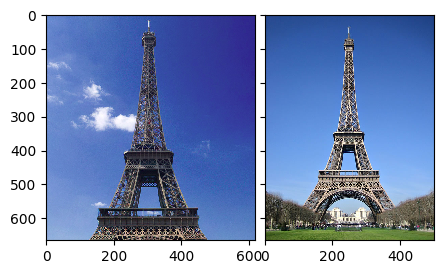

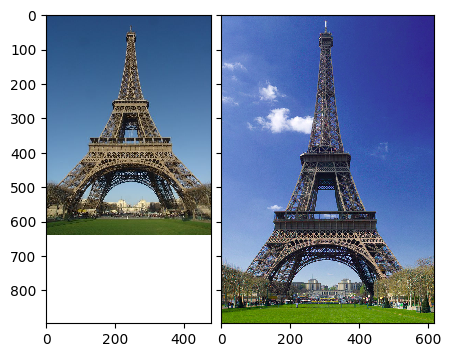

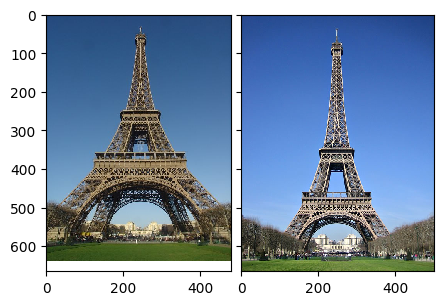

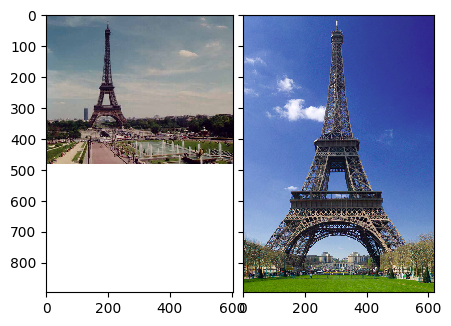

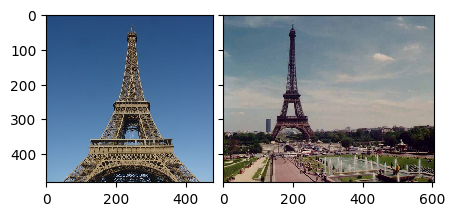

...

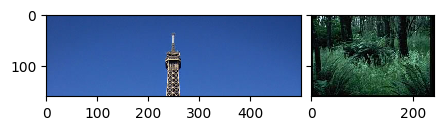

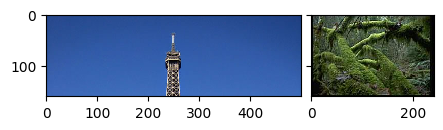

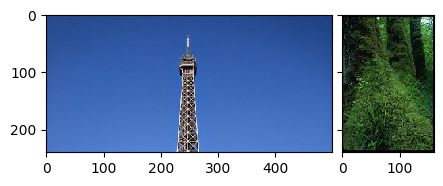

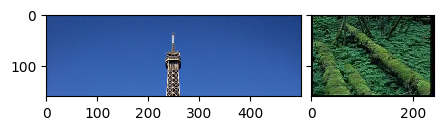

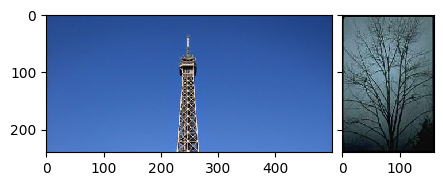

In [708]:
show_pairs(coral_images, find_nearest([get_histogram(i, 4) for i in lab_coral_images], N, intersection_distance))

**10. (10 баллов)** Посмотрите на изображения в папке *leaves*. Посчитайте дескрипторы Фурье для каждого листочка изображений. Выведите на экран 20 пар изображений с максимально похожими дескрипторами.

In [0]:
leaves_images = [cv2.cvtColor(cv2.imread(os.path.join(get_path('datasets/leaves'), filename)), cv2.COLOR_BGR2GRAY) for filename in os.listdir(get_path('datasets/leaves'))]

In [0]:
def approx(points, arctans, angle, idx):
    left = points[idx][0] ** 2 + points[idx][1] ** 2
    right = points[idx + 1][0] ** 2 + points[idx + 1][1] ** 2
    return left + (right - left) / (arctans[idx + 1] - arctans[idx]) * (angle - arctans[idx])

In [0]:
def fft_desсriptors(leaf_image, n):
    shift = np.transpose((leaf_image - 255).nonzero())
    points = shift - np.array([(np.max(shift[:, 0]) + np.min(shift[:, 0])) / 2.0, (np.max(shift[:, 1]) + np.min(shift[:, 1])) / 2.0])
    arctans = np.arctan2(points[:, 1], points[:, 0])
    order = np.argsort(arctans)
    cutpoint = np.argmax(np.array(list(map(lambda t: t[0] ** 2 + t[1] ** 2, list(points[order])))))
    order = np.roll(order, -cutpoint - 1)
    points, arctans = points[order], arctans[order]
    arctans[-1 - cutpoint:] += 2 * np.pi
    arctans = arctans - arctans[0]
    fft = np.fft.fft(np.array([approx(points, arctans, angle, np.searchsorted(arctans, angle, side='right') - 1) for angle in np.arange(n) * 2 * np.pi / n]))
    return fft[1:] / fft[0]

In [0]:
def fft_distance(hist1, hist2):
    return np.abs((hist1 - hist2) ** 2).sum()

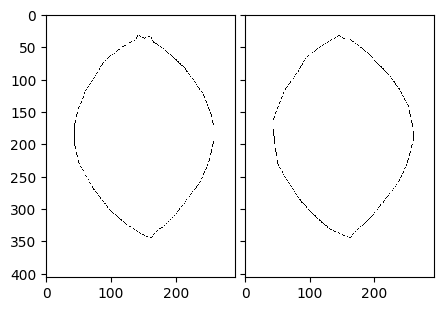

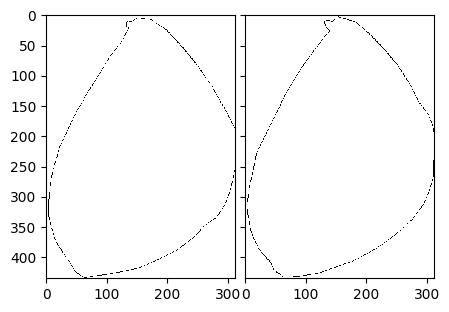

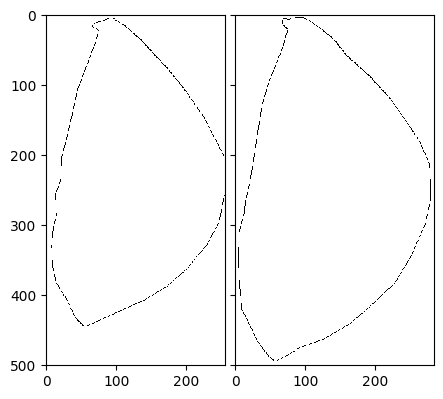

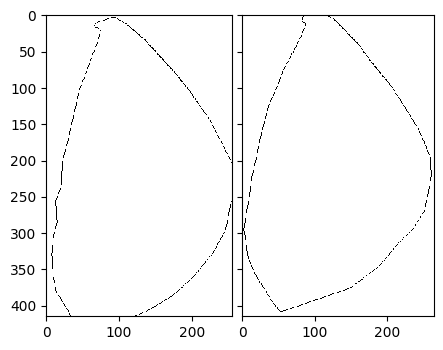

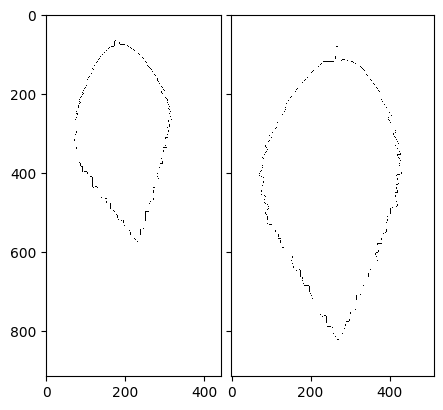

...

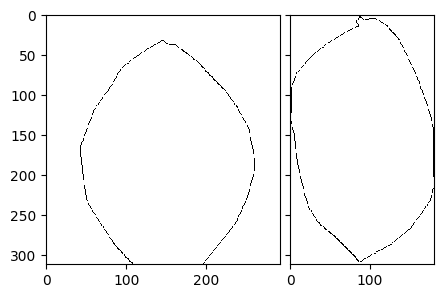

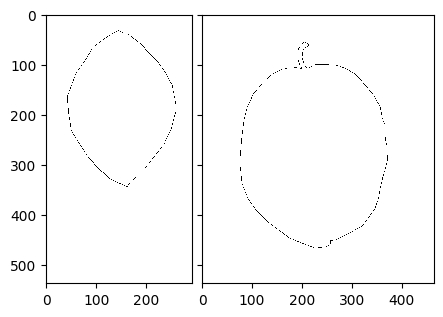

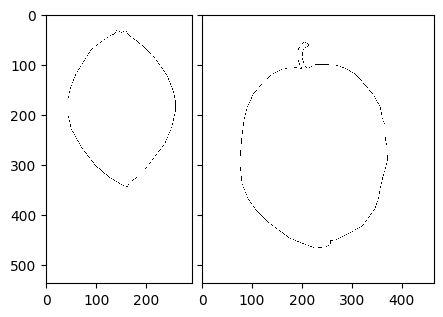

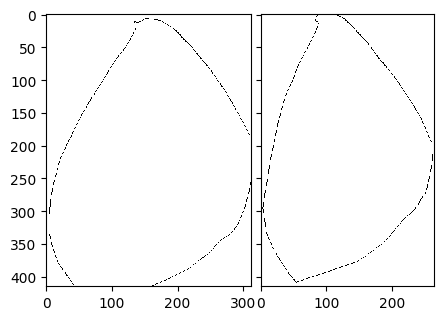

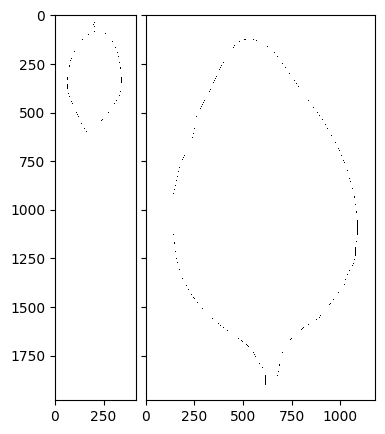

In [789]:
show_pairs([np.repeat(t[:, :, None], 3, axis=-1) for t in leaves_images], find_nearest([fft_desсriptors(i, 2 ** 10) for i in leaves_images], 20, fft_distance))